In [1]:
import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

In [2]:
# Install the Object Detection API
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Processing /content/models/research
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1697356 sha256=4fcbca10545edc873b49f587c25e547632eacee2e59276d1bd11540a5179e9cb
  Stored in directory: /tmp/pip-ephem-wheel-cache-f5hcuci0/wheels/53/dd/70/2de274d6c443c69d367bd6a5606f95e5a6df61aacf1435ec0d
Successfully built object-detection
  Attempting uninstall: object-detection
    Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-detection-0.1


In [8]:
import matplotlib
import matplotlib.pyplot as plt

import os
import random
import io
import imageio
import glob
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.utils import colab_utils
from object_detection.builders import model_builder

%matplotlib inline

In [9]:
#run model builder test
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py


2023-12-20 22:12:42.144416: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-20 22:12:42.144488: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-20 22:12:42.146818: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-12-20 22:12:43.599586: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Running tests under Python 3.10.12: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
W1220 22:12:47.326908 134644111548416 batch_normalization.py:1531] `tf.keras.layers.experimental.SyncBatchNormalization` end

In [10]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path.

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

def plot_detections(image_np,
                    boxes,
                    classes,
                    scores,
                    category_index,
                    figsize=(12, 16),
                    image_name=None):
  """Wrapper function to visualize detections.

  Args:
    image_np: uint8 numpy array with shape (img_height, img_width, 3)
    boxes: a numpy array of shape [N, 4]
    classes: a numpy array of shape [N]. Note that class indices are 1-based,
      and match the keys in the label map.
    scores: a numpy array of shape [N] or None.  If scores=None, then
      this function assumes that the boxes to be plotted are groundtruth
      boxes and plot all boxes as black with no classes or scores.
    category_index: a dict containing category dictionaries (each holding
      category index `id` and category name `name`) keyed by category indices.
    figsize: size for the figure.
    image_name: a name for the image file.
  """
  image_np_with_annotations = image_np.copy()
  viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_annotations,
      boxes,
      classes,
      scores,
      category_index,
      use_normalized_coordinates=True,
      min_score_thresh=0.8)
  if image_name:
    plt.imsave(image_name, image_np_with_annotations)
  else:
    plt.imshow(image_np_with_annotations)

In [11]:
!pip install fastapi kaleido python-multipart uvicorn
!pip install typing-extensions==4.5.0
!pip install tensorflow-probability==0.11.1 typing-extensions==3.10.0.2

#follow the link below to get your download code from from Roboflow
!pip install -q roboflow
from roboflow import Roboflow
rf = Roboflow(api_key="Yb7poFfr8gl42wa9TEne",model_format="tfrecord", notebook="roboflow-tf2-od")




  Using cached typing_extensions-4.9.0-py3-none-any.whl (32 kB)
  Attempting uninstall: typing-extensions
    Found existing installation: typing-extensions 3.10.0.2
    Uninstalling typing-extensions-3.10.0.2:
      Successfully uninstalled typing-extensions-3.10.0.2
  Using cached typing_extensions-4.5.0-py3-none-any.whl (27 kB)
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.9.0
    Uninstalling typing_extensions-4.9.0:
      Successfully uninstalled typing_extensions-4.9.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
fastapi 0.105.0 requires typing-extensions>=4.8.0, but you have typing-extensions 4.5.0 which is incompatible.
  Using cached typing_extensions-3.10.0.2-py3-none-any.whl (26 kB)
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.5.0
    Uninstalling ty

In [12]:

project = rf.workspace("georgia-institute-of-technology-bwqcc").project("pothole-detection-mev9q")
dataset = project.version(6).download("tfrecord")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Pothole-Detection-6 in tfrecord:: 100%|██████████| 11/11 [00:01<00:00,  9.30it/s]


In [13]:
# NOTE: Update these TFRecord names from "cells" and "cells_label_map" to your files!
test_record_fname = dataset.location + '/test/Potholes.tfrecord'
train_record_fname = dataset.location + '/train/Potholes.tfrecord'
label_map_pbtxt_fname = dataset.location + '/train/Potholes_label_map.pbtxt'

In [14]:
##change chosen model to deploy different models available in the TF2 object detection zoo
MODELS_CONFIG = {
    'efficientdet-d0': {
        'model_name': 'efficientdet_d0_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d0_512x512_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d0_coco17_tpu-32.tar.gz',
        'batch_size': 16
    },
    'efficientdet-d1': {
        'model_name': 'efficientdet_d1_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d1_640x640_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d1_coco17_tpu-32.tar.gz',
        'batch_size': 16
    },
    'efficientdet-d2': {
        'model_name': 'efficientdet_d2_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d2_768x768_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d2_coco17_tpu-32.tar.gz',
        'batch_size': 16
    },
        'efficientdet-d3': {
        'model_name': 'efficientdet_d3_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d3_896x896_coco17_tpu-32.config',
        'pretrained_checkpoint': 'efficientdet_d3_coco17_tpu-32.tar.gz',
        'batch_size': 16
    }
}

#in this tutorial we implement the lightweight, smallest state of the art efficientdet model
#if you want to scale up tot larger efficientdet models you will likely need more compute!
chosen_model = 'efficientdet-d0'

num_steps = 40000 #The more steps, the longer the training. Increase if your loss function is still decreasing and validation metrics are increasing.
num_eval_steps = 500 #Perform evaluation after so many steps

model_name = MODELS_CONFIG[chosen_model]['model_name']
pretrained_checkpoint = MODELS_CONFIG[chosen_model]['pretrained_checkpoint']
base_pipeline_file = MODELS_CONFIG[chosen_model]['base_pipeline_file']
batch_size = MODELS_CONFIG[chosen_model]['batch_size'] #if you can fit a large batch in memory, it may speed up your training

In [15]:
#download pretrained weights
%mkdir /content/models/research/deploy/
%cd /content/models/research/deploy/
import tarfile
download_tar = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/' + pretrained_checkpoint

!wget {download_tar}
tar = tarfile.open(pretrained_checkpoint)
tar.extractall()
tar.close()

/content/models/research/deploy
--2023-12-20 22:18:33--  http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d0_coco17_tpu-32.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.142.207, 74.125.195.207, 172.253.117.207, ...
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.142.207|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30736482 (29M) [application/x-tar]
Saving to: ‘efficientdet_d0_coco17_tpu-32.tar.gz’

efficientdet_d0_coc 100%[===================>]  29.31M   158MB/s    in 0.2s    

2023-12-20 22:18:34 (158 MB/s) - ‘efficientdet_d0_coco17_tpu-32.tar.gz’ saved [30736482/30736482]



In [16]:
#download base training configuration file
%cd /content/models/research/deploy
download_config = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/' + base_pipeline_file
!wget {download_config}

/content/models/research/deploy
--2023-12-20 22:19:07--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_efficientdet_d0_512x512_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4630 (4.5K) [text/plain]
Saving to: ‘ssd_efficientdet_d0_512x512_coco17_tpu-8.config’

ssd_efficientdet_d0 100%[===================>]   4.52K  --.-KB/s    in 0s      

2023-12-20 22:19:07 (27.0 MB/s) - ‘ssd_efficientdet_d0_512x512_coco17_tpu-8.config’ saved [4630/4630]



In [17]:
#prepare
pipeline_fname = '/content/models/research/deploy/' + base_pipeline_file
fine_tune_checkpoint = '/content/models/research/deploy/' + model_name + '/checkpoint/ckpt-0'

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_pbtxt_fname)


In [18]:
#write custom configuration file by slotting our dataset, model checkpoint, and training parameters into the base pipeline file

import re

%cd /content/models/research/deploy
print('writing custom configuration file')

with open(pipeline_fname) as f:
    s = f.read()
with open('pipeline_file.config', 'w') as f:

    # fine_tune_checkpoint
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)

    # tfrecord files train and test.
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 'input_path: "{}"'.format(test_record_fname), s)

    # label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set training batch_size.
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)

    # Set number of classes num_classes.
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)

    #fine-tune checkpoint type
    s = re.sub(
        'fine_tune_checkpoint_type: "classification"', 'fine_tune_checkpoint_type: "{}"'.format('detection'), s)

    f.write(s)



/content/models/research/deploy
writing custom configuration file


In [19]:
%cat /content/models/research/deploy/pipeline_file.config

 # SSD with EfficientNet-b0 + BiFPN feature extractor,
# shared box predictor and focal loss (a.k.a EfficientDet-d0).
# See EfficientDet, Tan et al, https://arxiv.org/abs/1911.09070
# See Lin et al, https://arxiv.org/abs/1708.02002
# Trained on COCO, initialized from an EfficientNet-b0 checkpoint.
#
# Train on TPU-8

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 1
    add_background_class: false
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      m

In [20]:
pipeline_file = '/content/models/research/deploy/pipeline_file.config'
model_dir = '/content/training/'

In [21]:

#!pip install --upgrade tensorflow
#!pip install tensorflow
!pip install tensorflow==2.13.0

!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 524.1/524.1 MB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 21.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 39.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 440.8/440.8 kB 15.4 MB/s eta 0:00:00
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.15.0
    Uninstalling tensorflow-estimator-2.15.0:
      Successfully uninstalled tensorflow-estimator-2.15.0
  Attempting uninstall: keras
    Found existing installation: keras 2.15.0
    Uninstalling keras-2.15.0:
      Successfully uninstalled keras-2.15.0
  Attempting uninstall: gast
    Found existing installation: gast 0.5.4
    Uninstalling gast-0.5.4:
      Successfully uninstalled gast-0.5.4
  Attempting uninstall: google-auth-oauthlib
    Found existing installation: google-auth-oauthlib 1.2.0
    Uninstalling google-auth-oauthlib-1.2.0:
      Successfully un

2023-12-20 22:21:51.089079: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:CPU:0',)
I1220 22:21:55.432639 134748877697024 mirrored_strategy.py:419] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:CPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 40000
I1220 22:21:55.476736 134748877697024 config_util.py:552] Maybe overwriting train_steps: 40000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1220 22:21:55.477022 134748877697024 config_util.py:552] Maybe overwriting use_bfloat16: False
I1220 22:21:55.730107 134748877697024 ssd_efficientnet_bifpn_feature_extractor.py:161] EfficientDet EfficientNet backbone version: efficientnet-b0
I1220 22:21:55.730333 134748877697024 ssd_efficientnet_bifpn_feature_extractor.py:163] EfficientDet BiFPN num filters: 64
I1220 22:21:55.730417 134748877697024 ssd_efficientnet_bi

In [23]:
%load_ext tensorboard
%tensorboard --logdir '/content/training/train'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 19941), started 0:01:23 ago. (Use '!kill 19941' to kill it.)

<IPython.core.display.Javascript object>

In [24]:
#see where our model saved weights
%ls '/content/training/'

checkpoint  ckpt-1.data-00000-of-00001  ckpt-1.index  train/


In [25]:
#run conversion script
import re
import numpy as np

output_directory = '/content/fine_tuned_model'

#place the model weights you would like to export here
last_model_path = '/content/training/'
print(last_model_path)
!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}

/content/training/
2023-12-20 22:36:12.300749: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
I1220 22:36:19.338551 134485769588736 ssd_efficientnet_bifpn_feature_extractor.py:161] EfficientDet EfficientNet backbone version: efficientnet-b0
I1220 22:36:19.343388 134485769588736 ssd_efficientnet_bifpn_feature_extractor.py:163] EfficientDet BiFPN num filters: 64
I1220 22:36:19.343893 134485769588736 ssd_efficientnet_bifpn_feature_extractor.py:164] EfficientDet BiFPN num iterations: 3
I1220 22:36:19.361553 134485769588736 efficientnet_model.py:143] round_filter input=32 output=32
I1220 22:36:19.480259 134485769588736 efficientnet_model.py:143] round_filter input=32 output=32
I1220 22:36:19.481715 134485769588736 efficientnet_model.py:143] round_filter input=16 output=16
I1220 22:36:20.093559 134485769588736 efficientnet_model.py:143] round_filter input=16 output=16
I1220 22:36:20.093868 134485769588736 efficientnet_model.py:143] round_filte

In [26]:
%ls '/content/fine_tuned_model/saved_model/'

assets/  fingerprint.pb  saved_model.pb  variables/


In [27]:
#downloading test images from Roboflow
#export dataset above with format COCO JSON
#or import your test images via other means.
%mkdir /content/test/
%cd /content/test/
!curl -L "https://universe.roboflow.com/ds/OHKHgOrrej?key=Hl5kiOLH4S" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content/test
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   2852      0 --:--:-- --:--:-- --:--:--  2862
100  284M  100  284M    0     0   128M      0  0:00:02  0:00:02 --:--:--  183M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/Potholes.tfrecord  
 extracting: test/Potholes_label_map.pbtxt  
   creating: train/
 extracting: train/Potholes.tfrecord  
 extracting: train/Potholes_label_map.pbtxt  
   creating: valid/
 extracting: valid/Potholes.tfrecord  
 extracting: valid/Potholes_label_map.pbtxt  


In [28]:
import matplotlib
import matplotlib.pyplot as plt

import io
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

%matplotlib inline

In [29]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: the file path to the image

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [30]:
%ls '/content/training/'

checkpoint  ckpt-1.data-00000-of-00001  ckpt-1.index  train/


In [31]:
import pathlib

filenames = list(pathlib.Path('/content/training/').glob('*.index'))

filenames.sort()
print(filenames)

#recover our saved model
pipeline_config = pipeline_file
#generally you want to put the last ckpt from training in here
model_dir = str(filenames[-1]).replace('.index','')
configs = config_util.get_configs_from_pipeline_file(pipeline_config)
model_config = configs['model']
detection_model = model_builder.build(
      model_config=model_config, is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(
      model=detection_model)
ckpt.restore(os.path.join(str(filenames[-1]).replace('.index','')))


def get_model_detection_function(model):
  """Get a tf.function for detection."""

  @tf.function
  def detect_fn(image):
    """Detect objects in image."""

    image, shapes = model.preprocess(image)
    prediction_dict = model.predict(image, shapes)
    detections = model.postprocess(prediction_dict, shapes)

    return detections, prediction_dict, tf.reshape(shapes, [-1])

  return detect_fn

detect_fn = get_model_detection_function(detection_model)

[PosixPath('/content/training/ckpt-1.index')]


In [32]:
#map labels for inference decoding
label_map_path = configs['eval_input_config'].label_map_path
label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

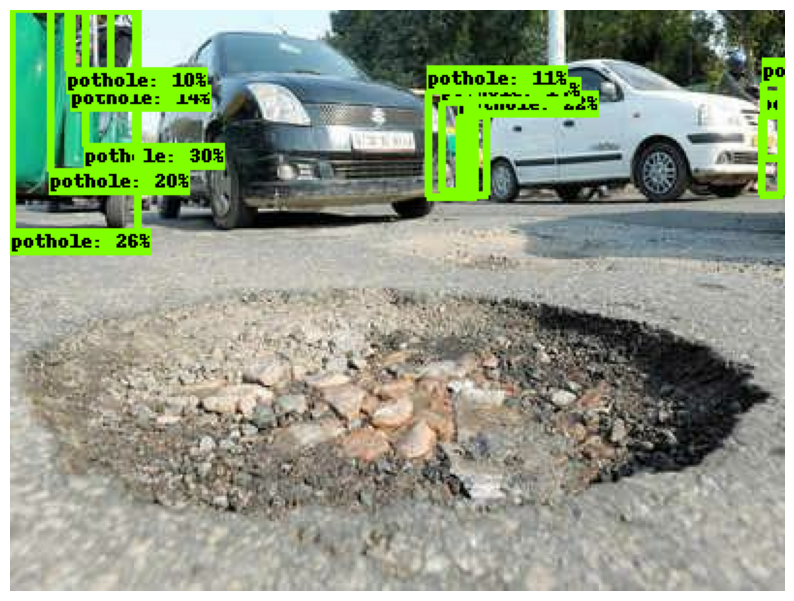

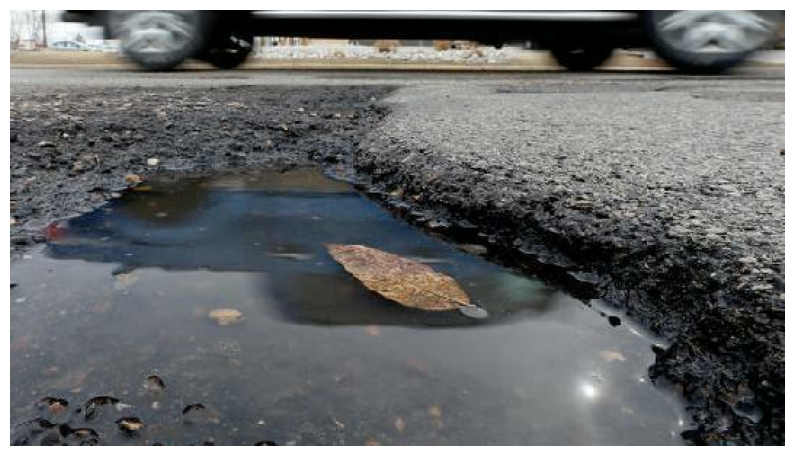

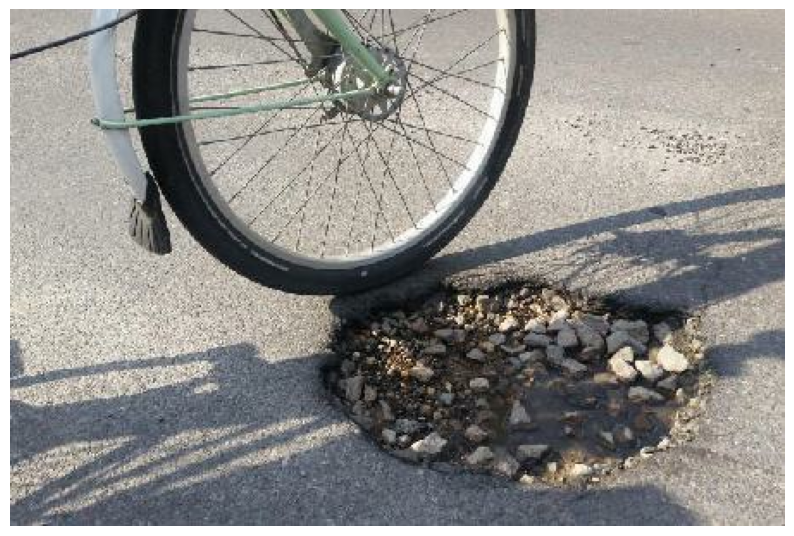

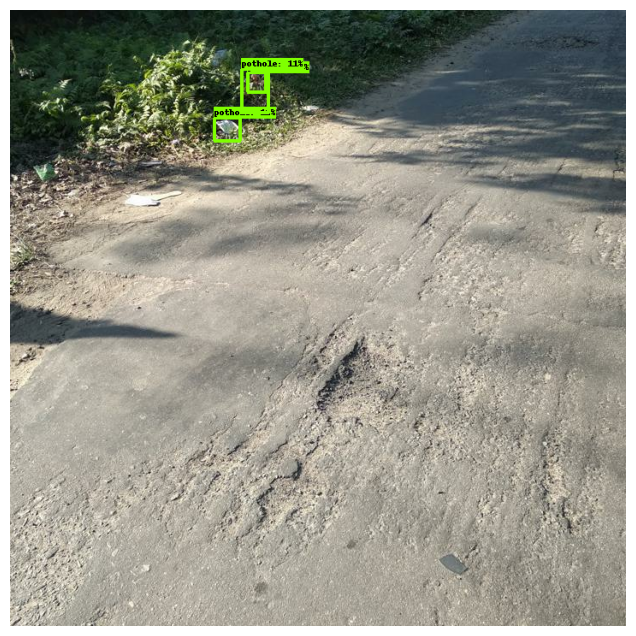

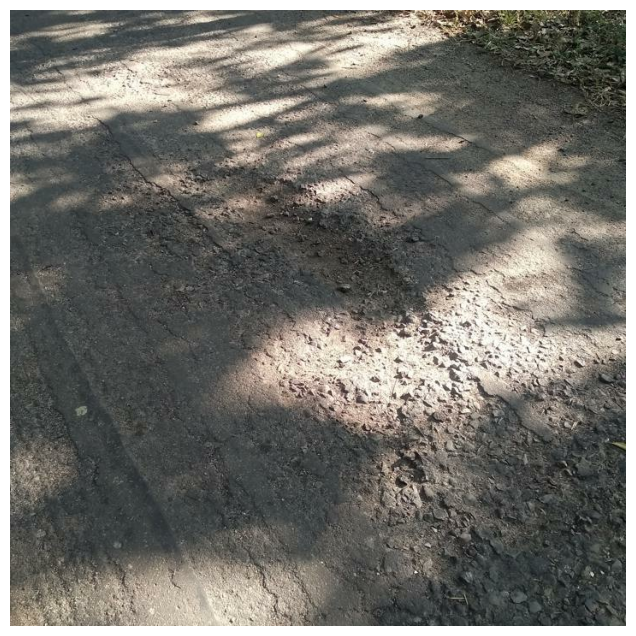

In [207]:
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
import matplotlib.pyplot as plt
import numpy as np
import os

# Load the trained model
detection_model = tf.saved_model.load('/content/models/research/deploy/efficientdet_d0_coco17_tpu-32/saved_model')

# Define the label map file path
label_map_path = '/content/Pothole-Detection-6/train/Potholes_label_map.pbtxt'

# Load label map data
category_index = label_map_util.create_category_index_from_labelmap(label_map_path, use_display_name=True)

# Output directory to save images with detection boxes
output_dir = '/content/output_images'
os.makedirs(output_dir, exist_ok=True)

def detect_objects(image_np):
    # Convert NumPy array to tensor
    input_tensor = tf.convert_to_tensor(image_np)
    input_tensor = input_tensor[tf.newaxis, ...]

    # Run inference
    detections = detection_model(input_tensor)

    # Process detections
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy() for key, value in detections.items()}
    detections['num_detections'] = num_detections

    # Convert detection classes to ints
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

    # Filter detections for potholes (class label assumed to be 1)
    pothole_indices = np.where(detections['detection_classes'] == 1)[0]
    detections = {key: value[pothole_indices] if isinstance(value, np.ndarray) else value for key, value in detections.items()}

    return detections

# Replace '/content/Pothole-Detection-6/test/Potholes.tfrecord' with your TFRecord file path
tfrecord_path = '/content/test/test/Potholes.tfrecord'

# Load TFRecord dataset
raw_dataset = tf.data.TFRecordDataset(tfrecord_path)

# Define a function to parse the TFRecord file
def parse_tfrecord_fn(example):
    feature_description = {
        'image/encoded': tf.io.FixedLenFeature([], tf.string),
        # Add more features here according to your TFRecord structure if needed
        # 'image/object/class/label': tf.io.FixedLenFeature([], tf.int64),
        # ...
    }
    return tf.io.parse_single_example(example, feature_description)

# Parse the TFRecord dataset
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)

# Iterate through the parsed dataset and detect potholes in the images
for i, example in enumerate(parsed_dataset.take(5)):  # Replace 5 with the number of images you want to extract
    # Extract the encoded image
    image_encoded = example['image/encoded']

    # Decode the image from bytes to a readable format
    decoded_image = tf.image.decode_image(image_encoded)

    # Convert the decoded image to a NumPy array
    image_np = decoded_image.numpy()

    # Detect potholes in the image
    detections = detect_objects(image_np)

    # Visualize and save the image with detections
    plt.figure(figsize=(10, 8))
    viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np,
        detections['detection_boxes'],
        detections['detection_classes'],
        detections['detection_scores'],
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=200,
        min_score_thresh=0.1,
        agnostic_mode=False)

    plt.imshow(image_np)
    plt.axis('off')

    # Save the image with detection boxes
    output_path = os.path.join(output_dir, f'image_{i+1}_with_detection.jpg')
    plt.savefig(output_path)
    plt.show()


In [209]:
# Initialize variables for performance calculation
true_positives = 0
false_positives = 0
false_negatives = 0
total_images = 0

# Iterate through the parsed dataset and detect potholes in the images
for i, example in enumerate(parsed_dataset.take(5)):  # Replace 5 with the number of images you want to extract
    # Extract the encoded image
    image_encoded = example['image/encoded']

    # Decode the image from bytes to a readable format
    decoded_image = tf.image.decode_image(image_encoded)

    # Convert the decoded image to a NumPy array
    image_np = decoded_image.numpy()

    # Detect potholes in the image
    detections = detect_objects(image_np)

    # Extract ground truth labels from your dataset (replace 'label' accordingly)
    ground_truth_labels = example['image/encoded'].numpy()  # Adjust 'label' based on your dataset structure

    # Get unique classes present in ground truth labels
    unique_ground_truth_labels = set(ground_truth_labels)

    # Compare the detected labels with ground truth labels
    for i in range(len(detections['detection_boxes'])):
        total_images += 1
        if detections['detection_classes'][i] in unique_ground_truth_labels:
            true_positives += 1
        else:
            false_positives += 1

    false_negatives += len(unique_ground_truth_labels) - true_positives

# Print intermediate values for analysis
print("True Positives:", true_positives)
print("False Positives:", false_positives)
print("False Negatives:", false_negatives)

# Calculate precision, recall, and accuracy
precision = true_positives / (true_positives + false_positives) if (true_positives + false_positives) > 0 else 0
recall = true_positives / (true_positives + false_negatives) if (true_positives + false_negatives) > 0 else 0

# Print performance results
print("Precision:", precision)
print("Recall:", recall)


True Positives: 94
False Positives: 0
False Negatives: 999
Precision: 1.0
Recall: 0.08600182982616651


In [210]:
import tensorflow as tf
from tabulate import tabulate

# Initialize variables for performance calculation
true_positives = 0
false_positives = 0
false_negatives = 0
total_images = 0

# Iterate through the parsed dataset and detect potholes in the images
for i, example in enumerate(parsed_dataset.take(5)):  # Replace 5 with the number of images you want to extract
    # Extract the encoded image
    image_encoded = example['image/encoded']

    # Decode the image from bytes to a readable format
    decoded_image = tf.image.decode_image(image_encoded)

    # Convert the decoded image to a NumPy array
    image_np = decoded_image.numpy()

    # Detect potholes in the image
    detections = detect_objects(image_np)

    # Extract ground truth labels from your dataset (replace 'label' accordingly)
    ground_truth_labels = example['image/encoded'].numpy()  # Adjust 'label' based on your dataset structure

    # Compare the detected labels with ground truth labels
    for i in range(len(detections['detection_boxes'])):
        total_images += 1
        if detections['detection_classes'][i] in ground_truth_labels:
            true_positives += 1
        else:
            false_positives += 1

    false_negatives += len(ground_truth_labels) - true_positives

# Calculate precision, recall, and accuracy
precision = (true_positives / (true_positives + false_positives)) * 100 if (true_positives + false_positives) > 0 else 0
recall = (true_positives / (true_positives + false_negatives)) * 100 if (true_positives + false_negatives) > 0 else 0

# Print performance results
print("Precision:", precision)
print("Recall:", recall)

# Create a list of tuples for tabular data
data = [
    ("Precision", f"{precision:.2f}%"),
    ("Recall", f"{recall:.2f}%"),
    # Add more metrics as needed
]

# Print the table
print(tabulate(data, headers=["Metric", "Value"], tablefmt="fancy_grid"))


Precision: 100.0
Recall: 0.025265625041997378
╒═══════════╤═════════╕
│ Metric    │ Value   │
╞═══════════╪═════════╡
│ Precision │ 100.00% │
├───────────┼─────────┤
│ Recall    │ 0.03%   │
╘═══════════╧═════════╛
